In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
from scipy.ndimage import gaussian_filter



def linear_noise(start=0.0001, end=0.02, steps=500):
    return np.linspace(start, end, steps)
def get_index_from_list(lst, t, shape, device="cpu"):
    """
    Get the parameter value from a precomputed list for time `t`.

    Args:
        lst: Precomputed list of parameters.
        t: Current timestep.
        shape: Shape of the target tensor (to ensure correct broadcasting).
        device: Device for computation (e.g., 'cpu' or 'cuda').

    Returns:
        Tensor with the same batch size as the input, reshaped for broadcasting.
    """
    value = torch.tensor(lst, dtype=torch.float32, device=device)[t]
    # Reshape to match the batch size and spatial dimensions (height, width)
    return value.view(1, 1, 1, 1).expand(shape[0], 1, shape[2], shape[3])



def generate_turbidity_noise(shape, device="cpu", blur_sigma=10):
    """
    Generates spatially smooth noise to imitate underwater turbidity.
    - shape: Shape of the noise tensor (batch_size, channels, height, width)
    - device: Device to place the tensor on (e.g., 'cpu' or 'cuda')
    - blur_sigma: Standard deviation for Gaussian blur to smooth the noise
    """
    # Generate uniform noise in the range [-1, 1]
    noise = (torch.rand(shape) * 2 - 1).cpu().numpy()

    # Apply Gaussian blur to smooth the noise
    for channel in range(noise.shape[1]):  # Apply blur per channel
        noise[:, channel, :, :] = gaussian_filter(noise[:, channel, :, :], sigma=blur_sigma)

    return torch.tensor(noise, dtype=torch.float32).to(device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    # Generate turbidity-like noise
    noise = generate_turbidity_noise(x_0.shape, device=device, blur_sigma=10)

    # Fetch precomputed values
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x_0.shape)

    # Mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
        + sqrt_one_minus_alphas_cumprod_t.to(device) * noise, noise

# Define beta schedule
betas = torch.tensor(linear_noise(), dtype=torch.float32)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, 0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

# Example of usage
x_0 = torch.randn(1, 3, 64, 64)  # Example input (batch_size, channels, height, width)
t = torch.randint(0, len(betas), (1,))  # Random timestep
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Perform forward diffusion sampling
noisy_image, noise = forward_diffusion_sample(x_0, t, device=device)

print(noisy_image.shape, noise.shape)  # Output the shapes of the noisy image and noise


torch.Size([1, 3, 64, 64]) torch.Size([1, 3, 64, 64])


<ipython-input-1-9baf2903ac31>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  value = torch.tensor(lst, dtype=torch.float32, device=device)[t]


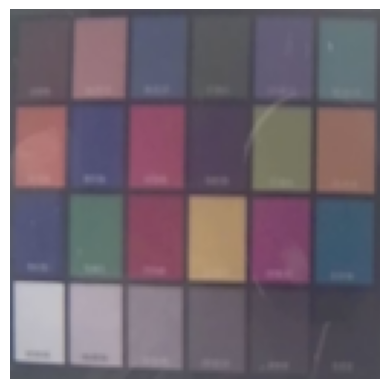

In [ ]:

import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import os
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt

import re
import torchvision.transforms.functional as TF
# Define the transformation pipeline
IMG_SIZE = 128
data_transforms = [
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),  # Scales data into [0,1]
    transforms.Lambda(lambda t: (t * 2) - 1)  # Scale between [-1, 1]
]
data_transform = transforms.Compose(data_transforms)

# Example function to convert and display a single image
def convert_and_show_single_image(image_path):
    # Open the image using PIL
    image = Image.open(image_path)

    # Apply the transformations to the image
    image_tensor = data_transform(image)

    # Visualize the image (convert back to the original format for display)
    show_tensor_image(image_tensor)

# Function to reverse the transformations for display
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),  # Rescale back to [0, 1]
        transforms.Lambda(lambda t: t.permute(1, 2, 0)),  # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),  # Rescale to [0, 255]
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),  # Convert to numpy array
        transforms.ToPILImage(),  # Convert back to PIL Image for display
    ])

    # If the image tensor has more than 1 sample, select the first one
    if len(image.shape) == 4:
        image = image[0, :, :, :]

    # Display the image
    plt.imshow(reverse_transforms(image))
    plt.axis('off')  # Hide axes for better visualization
    plt.show()

# Example usage: Provide the path to an image
image_path = '/content/drive/MyDrive/Colab Notebooks/turbid  water images/10000.jpg'  # Replace with the path to an image
convert_and_show_single_image(image_path)


Processing batch 1/5...


<ipython-input-1-9baf2903ac31>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  value = torch.tensor(lst, dtype=torch.float32, device=device)[t]


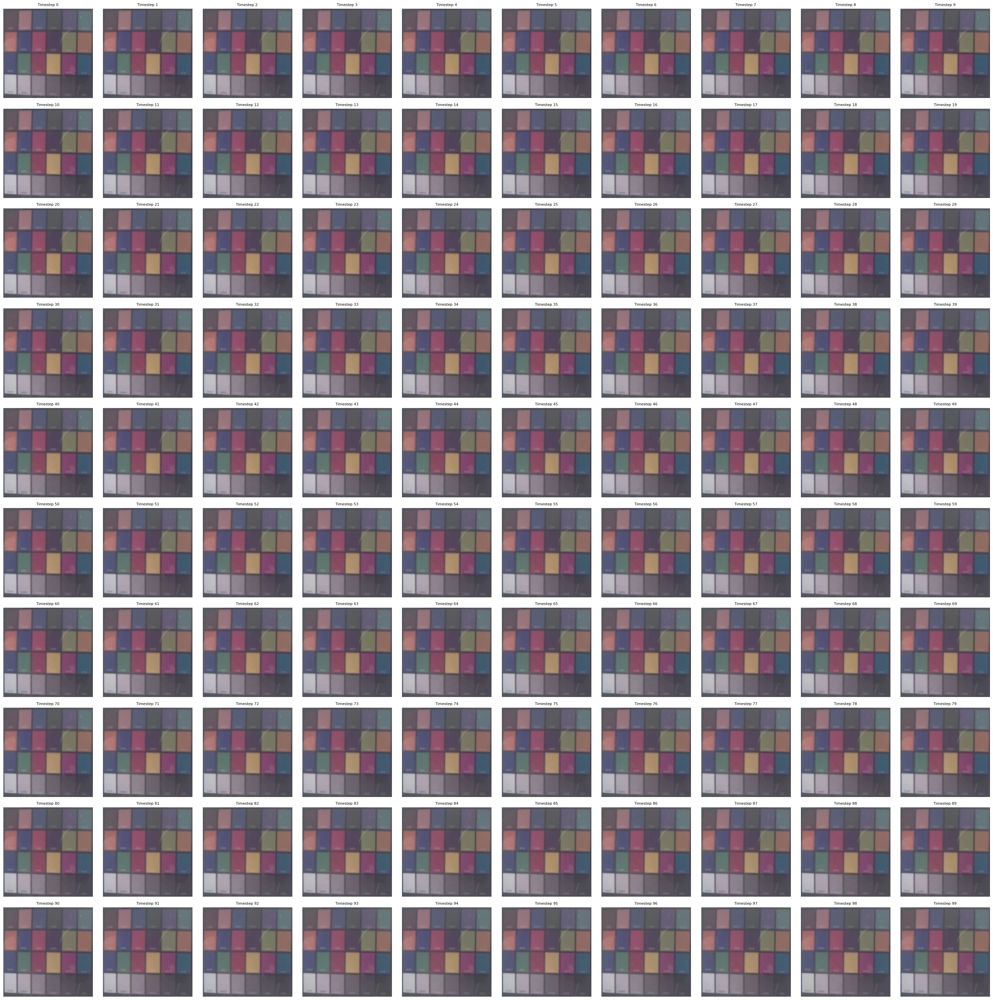

Processing batch 2/5...


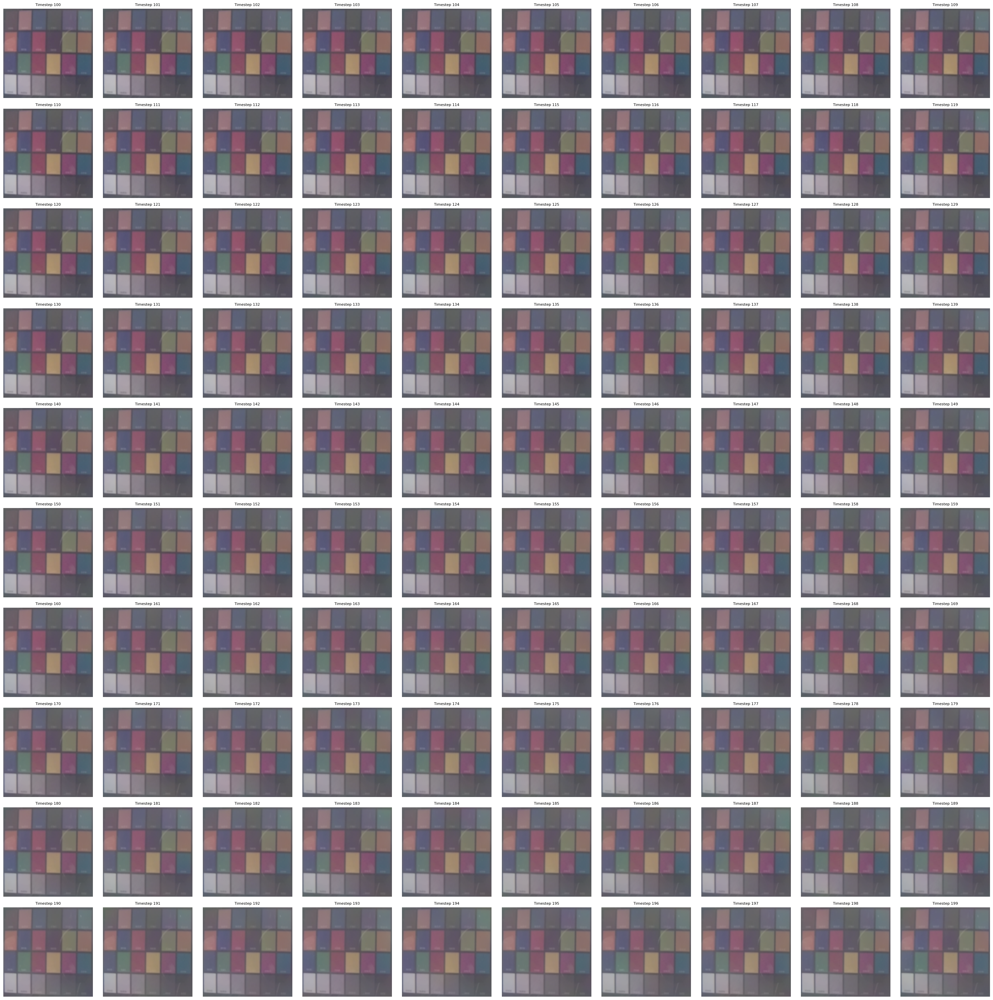

Processing batch 3/5...


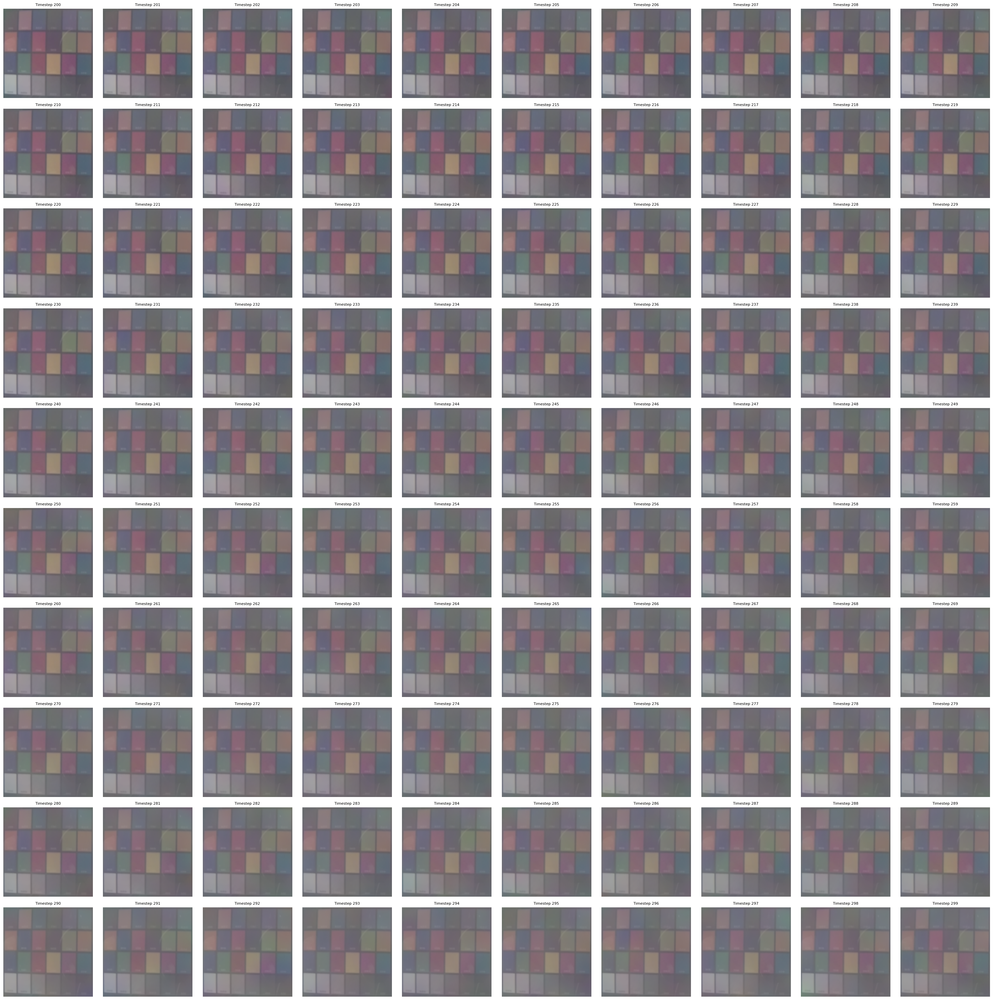

Processing batch 4/5...


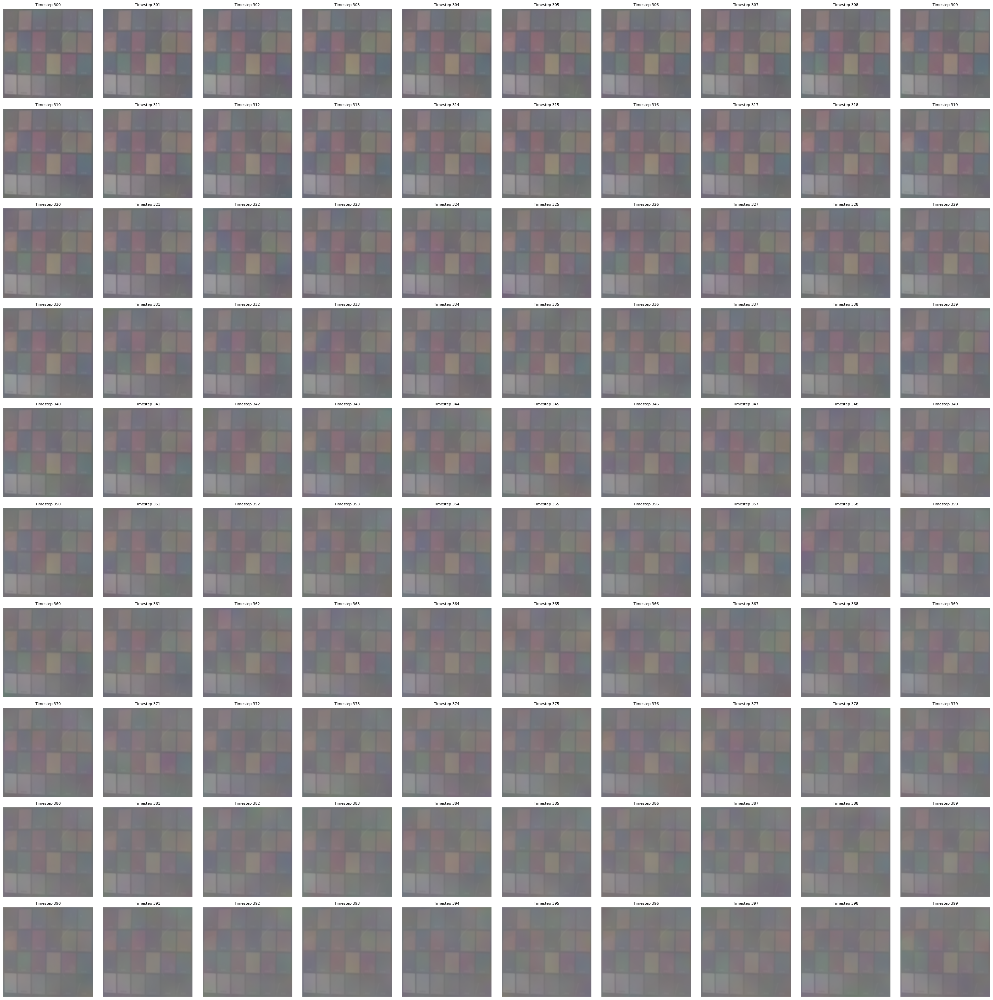

Processing batch 5/5...


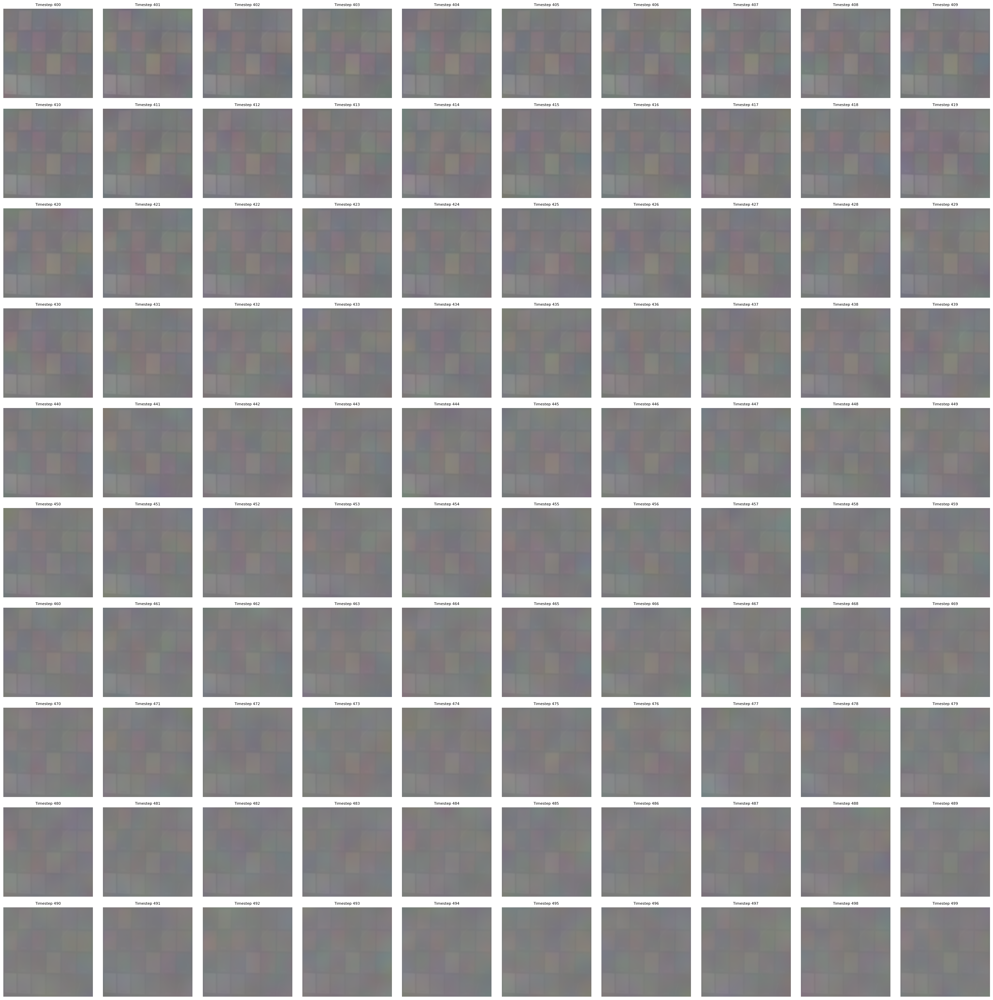

In [ ]:
import torch
from torchvision import transforms, datasets
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt# Define the path to your image
image_path = '/content/drive/MyDrive/Colab Notebooks/turbid  water images/10000.jpg'

# Load and transform the image
image = Image.open(image_path)
image_tensor = data_transform(image)  # Transform the image to a tensor
image_tensor = image_tensor.unsqueeze(0)  # Add batch dimension: (1, 3, 64, 64)

# Simulate forward diffusion and visualize the results
T = 500 # Total timesteps
num_per_batch = 100  # Number of images per batch for display
stepsize = 1  # Show every timestep
batches = T // num_per_batch  # Total batches
noisy_images_list = []


def show_tensor_image_fixed(image_tensor):
    """Convert tensor to image, ensuring pixel range is [0, 1]."""
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),  # Rescale back to [0, 1]
        transforms.Lambda(lambda t: torch.clamp(t, 0, 1)),  # Ensure pixel values in [0, 1]
        transforms.Lambda(lambda t: t.permute(1, 2, 0).cpu().numpy()),  # CHW to HWC for display
    ])

    # If the tensor has a batch dimension, take the first item
    if len(image_tensor.shape) == 4:
        image_tensor = image_tensor[0]

    # Apply reverse transforms
    img_np = reverse_transforms(image_tensor)
    plt.imshow(img_np)
    plt.axis('off')

# Loop through all timesteps and display in batches
for batch in range(batches):
    print(f"Processing batch {batch + 1}/{batches}...")
    plt.figure(figsize=(30, 30))

    for idx in range(num_per_batch):
        timestep = batch * num_per_batch + idx
        t = torch.Tensor([timestep]).type(torch.int64)  # Current timestep
        noisy_image, _ = forward_diffusion_sample(image_tensor, t)  # Get noisy image

        noisy_images_list.append(noisy_image)  # Append to the list

        # Subplot for each image in the batch
        plt.subplot(10, 10, idx + 1)  # 5 rows x 10 columns = 50 images
        show_tensor_image_fixed(noisy_image)
        plt.title(f"Timestep {timestep}", fontsize=8)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


In [ ]:
from torchvision import transforms
from PIL import Image
import torch
import os

# Define constants
IMG_SIZE = 128
ground_truth_dir = '/content/drive/MyDrive/Colab Notebooks/turbid  water images'

# Transformation pipeline
data_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),  # Resize to consistent size
    transforms.ToTensor(),
    transforms.Lambda(lambda t: (t * 2) - 1)  # Scale between [-1, 1]
])

# Load ground truth images
ground_truth_images = []  # List to store ground truth tensors
ground_truth_files = sorted(os.listdir(ground_truth_dir))[:500] # Load up to 500 images

for img_file in ground_truth_files:
    img_path = os.path.join(ground_truth_dir, img_file)
    image = Image.open(img_path).convert('RGB')  # Ensure 3-channel RGB
    image_tensor = data_transforms(image)  # Apply transformations
    ground_truth_images.append(image_tensor.unsqueeze(0))  # Add batch dimension

# Combine all ground truth tensors into a single batch
ground_truth_images = torch.cat(ground_truth_images)  # Shape: (batch_size, channels, height, width)

# Ensure noisy images match ground truth
noisy_images_list = noisy_images_list[:len(ground_truth_images)]


In [ ]:
import torch
import torch.nn as nn

# Define loss function
loss_function = nn.MSELoss()

# List to store average loss per epoch
epoch_losses = []

# Run for 10 epochs
num_epochs = 10
for epoch in range(num_epochs):
    total_loss = 0.0

    for noisy, ground_truth in zip(noisy_images_list, ground_truth_images):
        loss = loss_function(noisy, ground_truth)
        total_loss += loss.item()

    avg_loss = total_loss / len(ground_truth_images)
    epoch_losses.append(avg_loss)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss:.6f}")



Epoch 1/10, Loss: 0.116564
Epoch 2/10, Loss: 0.116564
Epoch 3/10, Loss: 0.116564
Epoch 4/10, Loss: 0.116564
Epoch 5/10, Loss: 0.116564
Epoch 6/10, Loss: 0.116564
Epoch 7/10, Loss: 0.116564
Epoch 8/10, Loss: 0.116564
Epoch 9/10, Loss: 0.116564
Epoch 10/10, Loss: 0.116564


Epoch 1/10, Loss: 0.009264967648113695, Sigma: -1.3957074385118062e-09
Epoch 2/10, Loss: 2.5937489810088287e-20, Sigma: -1.7241452709981786e-10
Epoch 3/10, Loss: 1.6321266082763663e-22, Sigma: -1.010884709273796e-10
Epoch 4/10, Loss: 2.1025828273343844e-23, Sigma: -8.293676162507424e-11
Epoch 5/10, Loss: 6.167458651139679e-24, Sigma: -7.471567115002742e-11
Epoch 6/10, Loss: 2.4087499760977138e-24, Sigma: -7.008305741296184e-11
Epoch 7/10, Loss: 1.2793727062551853e-24, Sigma: -6.676006969463799e-11
Epoch 8/10, Loss: 7.058608048928481e-25, Sigma: -6.427875592907029e-11
Epoch 9/10, Loss: 4.4116300650929655e-25, Sigma: -6.213193848303433e-11
Epoch 10/10, Loss: 2.5587454377539196e-25, Sigma: -6.050659973055872e-11
Optimized Sigma: -6.050659973055872e-11


Epoch 1/10, Loss: 0.009301663733448822, Sigma: -1.405531024900597e-09
Epoch 2/10, Loss: 2.6448224236346937e-20, Sigma: -1.7263494800356938e-10
Epoch 3/10, Loss: 1.6360970694184932e-22, Sigma: -1.0148469564708051e-10
Epoch 4/10, Loss: 2.1855214729525626e-23, Sigma: -8.264023493298467e-11
Epoch 5/10, Loss: 5.840998057088375e-24, Sigma: -7.480416980287785e-11
Epoch 6/10, Loss: 2.5499221358141058e-24, Sigma: -6.988475076408207e-11
Epoch 7/10, Loss: 1.2529029234980448e-24, Sigma: -6.658826962047115e-11
Epoch 8/10, Loss: 6.705677635832435e-25, Sigma: -6.42349159973854e-11
Epoch 9/10, Loss: 4.941025672904121e-25, Sigma: -6.18756226811179e-11
Epoch 10/10, Loss: 2.7352106324690294e-25, Sigma: -6.014524989161885e-11
Optimized Sigma: -6.014524989161885e-11
Plot saved as 'sigma_vs_epochs.png'


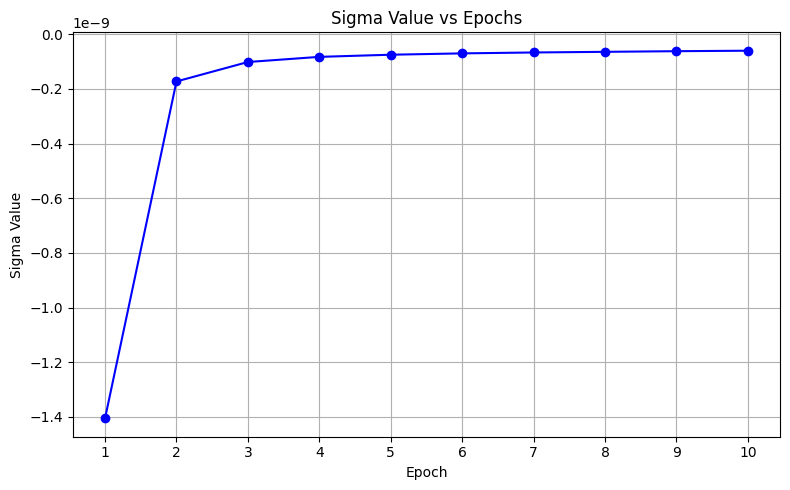

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from PIL import Image
import os
import matplotlib.pyplot as plt

# Define constants
IMG_SIZE = 128
ground_truth_dir = '/content/drive/MyDrive/Colab Notebooks/turbid  water images'

# Transformation pipeline
data_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Lambda(lambda t: (t * 2) - 1)  # Scale between [-1, 1]
])

# Load ground truth images
ground_truth_images = []
ground_truth_files = sorted(os.listdir(ground_truth_dir))[:500]  # Load up to 500 images

for img_file in ground_truth_files:
    img_path = os.path.join(ground_truth_dir, img_file)
    image = Image.open(img_path).convert('RGB')
    image_tensor = data_transforms(image)
    ground_truth_images.append(image_tensor.unsqueeze(0))

# Combine ground truth tensors into a single batch
ground_truth_images = torch.cat(ground_truth_images)  # Shape: (batch_size, channels, height, width)

# Define initial sigma (learnable parameter)
sigma = torch.tensor([0.5], requires_grad=True)

# Define optimizer and loss function
optimizer = optim.Adam([sigma], lr=0.01)
loss_function = nn.MSELoss()

# Store sigma values per epoch
sigma_history = []

# Forward diffusion function
def forward_diffusion(image, sigma):
    noise = torch.randn_like(image) * sigma
    noisy_image = image + noise
    return noisy_image

# Optimization loop
num_epochs = 10
for epoch in range(num_epochs):
    total_loss = 0.0

    for gt_image in ground_truth_images:
        # Create noisy image using current sigma
        noisy_image = forward_diffusion(gt_image, sigma)

        # Compute loss between noisy and ground truth image
        loss = loss_function(noisy_image, gt_image)

        # Backpropagation and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    # Record sigma value
    sigma_history.append(sigma.item())

    # Print progress
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {total_loss / len(ground_truth_images)}, Sigma: {sigma.item()}")

# Final optimized sigma
print(f"Optimized Sigma: {sigma.item()}")

# Plot and save sigma vs epoch graph
epochs = list(range(1, num_epochs + 1))

plt.figure(figsize=(8, 5))
plt.plot(epochs, sigma_history, marker='o', linestyle='-', color='b')
plt.title('Sigma Value vs Epochs')
plt.xlabel('Epoch')
plt.ylabel('Sigma Value')
plt.grid(True)
plt.xticks(epochs)
plt.tight_layout()
plt.savefig('sigma_vs_epochs.png')
print("Plot saved as 'sigma_vs_epochs.png'")
